In [3]:
from IPython.display import Image

In [4]:
#!pip install wandb

In [5]:
from __future__ import print_function
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [6]:
# Set random seed for reproducibility
manualSeed = 121
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  121


In [7]:
from torchvision import transforms, datasets
from torch.utils.data import DataLoader, Dataset
from torchvision.datasets import ImageFolder

In [6]:
import wandb

In [7]:
wandb.login()

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: anzovi (anzovitte). Use `wandb login --relogin` to force relogin


True

In [2]:
# import glob
# from PIL import Image
# import matplotlib.pyplot as plt

In [3]:
# images = glob.glob("img_align_celeba/img_align_celeba/*.jpg")
# imageCount = 0
# for image in images:
#     imageCount +=1
#     #with open(image, 'rb') as file:
#         #img = Image.open(file)
#         #imageSet.append(Image.open(file))
#         #img.show()
# print(imageCount)

202599


In [9]:
# Дирректория с изображениями
#dataroot = "C:\\Users\\Sky\\EveryPixel\\Project_Edu\\img_align_celeba"
dataroot = "C:/Users/Andrej/1_GAN_2/img_align_celeba"
# Количество воркеров для сборки датасета
workers = 2

# Размер батча
batch_size = 128*2

# Размер входа сети для изображений. Все изображения ресайзятся к нему
image_size = 128

# Количество каналов цвета
nc = 3

# Размер латентного вектора (размерность латентного пространства)
nz = 100

# Size of feature maps in generator
ngf = 128

# Рамер карты признаков для генератора
ndf = 128

# Кол-во эпох
num_epochs = 1

# Лернингрейт
lr = 0.0002

# Параметр для оптимизатора Adam
beta1 = 0.9

# Количество GPU, 0 если считаем на CPU
ngpu = 1

# Загрузка данных

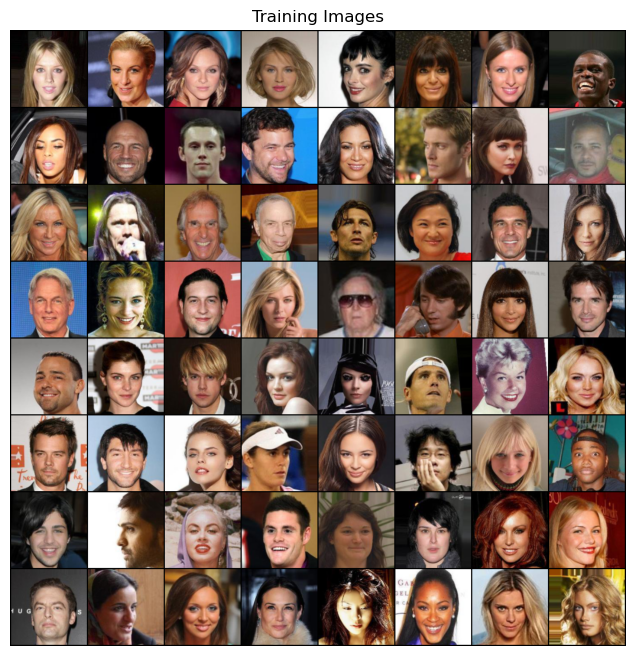

In [10]:
# Для создания датасета используем класс ImageFolder
# Создаем датасет
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Создаем даталоадер
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Выбираем девайс для вычислений
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Нарисуем часть картинок из датасета
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

# Не рабочая версия
Архитектура генератора намного сложнее дискриминатора, и поэтому лосс функция быстро уходит вверх у дискриминатора, при добавлении нескольких слоев в дискриминатор лосс функция дискриминатора стабилизировалась.
Видимо это связано с тем что генератор быстро обучается обманывать дискриминатор, поэтому дискриминатор быстро улетает в 100.

In [ ]:
# class CSPupBlock(nn.Module):
#     def __init__(self, npf):
#         super(CSPupBlock, self).__init__()
#         #Aux
#         ## При учете если npf = 256
#         #self.deconv = nn.ConvTranspose2d( 100, npf*2, 8, 1, 0, bias=False) # shape (1,100, 1, 1) -> (1,1024, 8, 8)
        
#         self.deconv = nn.ConvTranspose2d( nz, npf * 2, 4, 1, 0, bias=False) # shape (1,100, 1, 1) -> (1,1024, 4, 4)
#         self.norm = nn.BatchNorm2d(npf*2)
#         self.rel = nn.ReLU(True)
        
#         #Split 1
#         self.upsample0_0 = nn.ConvTranspose2d(npf, npf, kernel_size = 4,stride = 2, padding = 1, bias=False)
#         self.norm0_0 = nn.InstanceNorm2d(npf)
        
        
#         #Split 2
#         self.conv1d0_1 = nn.Conv1d(npf, npf,kernel_size = 3, stride=1, padding = 1, bias=False)
#         self.norm0_1= nn.InstanceNorm1d(npf)
        
#         self.relu0_1 = nn.ReLU(True)
        
#         self.upsample1_1 = nn.ConvTranspose2d(npf, npf, kernel_size = 4,stride = 2, padding = 1, bias=False)
#         self.norm1_1 = nn.InstanceNorm2d(npf)
        
#         self.conv3d0_1 = nn.Conv3d(npf, npf, kernel_size = 3, stride=1, padding = 1, bias=False)
#         self.norm2_1 = nn.InstanceNorm3d(npf)
        
#         self.relu1_1 = nn.ReLU(True)
        
#         self.conv3d1_1 = nn.Conv3d(npf, npf, kernel_size = 3, stride=1, padding = 1, bias=False)
#         self.norm3_1 = nn.InstanceNorm3d(npf)

#     def forward(self,x):
#         B_num, Ch, H, W = x.size()
#         #print(B_num, Ch, H, W)
        
#         if (H == 1 and W == 1):
#             #Так как по видео памяти не вытягивает машина - скипнули блок с глубиной 1024, начинаем с npf = 512
#             ## shape (1,100, 1, 1) -> (1,1024, 4, 4)
#             x = self.deconv(x)
#             x = self.norm(x)
#             x = self.rel(x)
#             B_num, Ch, H, W = x.size()
#             #print(x.size())

#         #shape (1,1024, 4, 4) -> (1,512, 4, 4) , (1,512, 4, 4)
#         x_1, x_2 = x[:,Ch//2:,:,:] , x[:,:Ch//2,:,:]

#         #Split 1
#         #Upsample
#         ## shape (1,512, 4, 4) -> (1,512, 8, 8)
#         x_1 = self.upsample0_0(x_1)
#         x_1 = self.norm0_0(x_1)


#         #Split 2
#         ## shape (1,512, 4, 4) -> (1,512, 16)
#         x_2 = x_2.reshape(B_num, Ch//2, H*W)
#         #Conv1
#         x_2 = self.conv1d0_1(x_2)
#         x_2 = self.norm0_1(x_2)

#         #Relu
#         x_2 = self.relu0_1(x_2)

#         ## shape (1,512, 16) -> (1,512, 4, 4)
#         x_2 = x_2.reshape(B_num, Ch//2, H, W)

#         ## shape (1,512, 4, 4) -> (1,512, 8, 8)
#         # Upsample
#         x_2 = self.upsample1_1(x_2)
#         x_2 = self.norm1_1(x_2)


#         ## shape (1,512, 8, 8) -> (1,512, 1, 8, 8)
#         x_2 = x_2.reshape(B_num,Ch//2, 1, 2*H ,2*W)

#         #conv3
#         x_2 = self.conv3d0_1(x_2)
#         x_2 = self.norm2_1(x_2)
#         #Relu
#         x_2 = self.relu1_1(x_2)
#         #conv3
#         x_2 = self.conv3d1_1(x_2)
#         x_2 = self.norm3_1(x_2)
#         ## shape (1,256, 1, 8, 8) -> (1,256, 8, 8)
#         x_2 = x_2.reshape(B_num,Ch//2, 2*H ,2*W)
    
#         return x_1 + x_2
        

In [55]:
%%time
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# Для каждой эпохи
for epoch in range(num_epochs):
    # Для каждого батча
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Учим дискриминатор: максимизируем log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Для батча
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Прямой прогон батча из реальных картинок D
        output = netD(real_cpu).view(-1)
        # Считаем лосс на всем батче реальных картинок
        errD_real = criterion(output, label)
        # Вычисляем градиенты для дискриминатора
        errD_real.backward()
        D_x = output.mean().item()

        ## Учим на полном фейковом батче
        # Генерируем бат латентных векторов
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        
        # Генерируем фековый батч с помощью G
        fake = netG(noise)
        label.fill_(fake_label)
        # Классифицируем фековый батч с помощью D
        output = netD(fake.detach()).view(-1)
        # Вычисляем лосс дискриминатора на фейковом батче
        errD_fake = criterion(output, label)
        # Вычисляем градиент для фейкового батча, он суммируется с предидущим
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Вычисляем ошибку на реальном и фековом батчах
        errD = errD_real + errD_fake
        # Обновляем веса D
        optimizerD.step()

        ############################
        # (2) Учим генератор: максимизируем log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # для генератора фейковые метки есть реальные (0 меняем на 1)
        # Так как мы обновили веса дискриминатора прогоним фековый батч через него еще  раз
        output = netD(fake).view(-1)
        # Вычислим лосс G основываясь на выходе D
        errG = criterion(output, label)
        # Вычислим градиент для G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Обновляем веса G
        optimizerG.step()
        
        #run.log({"lossD": errD})
        #run.log({"lossG": errG})
        # Выводим статистику обучения
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Сохраним лоссы
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Проверим какие картинки рисует генератор
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/1][0/792]	Loss_D: 2.1604	Loss_G: 20.9761	D(x): 0.5594	D(G(z)): 0.5384 / 0.0000
[0/1][50/792]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


KeyboardInterrupt: 

# Рабочая версия

## Модель

In [11]:
# кастомная инициализация весов netG или netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [12]:
class CSPupBlock(nn.Module):
    def __init__(self, npf):
        super(CSPupBlock, self).__init__()
        #Aux
        ## При учете если npf = 256
        #self.deconv = nn.ConvTranspose2d( 100, npf*2, 8, 1, 0, bias=False) # shape (1,100, 1, 1) -> (1,1024, 8, 8)
        
        self.deconv = nn.ConvTranspose2d( nz, npf, 8, 1, 0, bias=False) # shape (1,100, 1, 1) -> (1,1024, 4, 4)
        self.norm = nn.BatchNorm2d(npf)
        self.rel = nn.ReLU(True)
        
        #Split 1
        self.upsample0_0 = nn.ConvTranspose2d(npf, npf, kernel_size = 4,stride = 2, padding = 1, bias=False)
        self.norm0_0 = nn.InstanceNorm2d(npf)
        
        
        #Split 2
        self.conv1d0_1 = nn.Conv1d(npf, npf,kernel_size = 3, stride=1, padding = 1, bias=False)
        self.norm0_1= nn.InstanceNorm1d(npf)
        
        self.relu0_1 = nn.ReLU(True)
        
        self.upsample1_1 = nn.ConvTranspose2d(npf, npf, kernel_size = 4,stride = 2, padding = 1, bias=False)
        self.norm1_1 = nn.InstanceNorm2d(npf)
        
        self.conv3d0_1 = nn.Conv3d(npf, npf, kernel_size = 3, stride=1, padding = 1, bias=False)
        self.norm2_1 = nn.InstanceNorm3d(npf)
        
        self.relu1_1 = nn.ReLU(True)
        
        self.conv3d1_1 = nn.Conv3d(npf, npf, kernel_size = 3, stride=1, padding = 1, bias=False)
        self.norm3_1 = nn.InstanceNorm3d(npf)

    def forward(self,x):
        B_num, Ch, H, W = x.size()
        #print(B_num, Ch, H, W)
        
        if (H == 1 and W == 1):
            #Так как по видео памяти не вытягивает машина - скипнули блок с глубиной 1024, начинаем с npf = 512
            ## shape (1,100, 1, 1) -> (1,1024, 4, 4)
            x = self.deconv(x)
            x = self.norm(x)
            x = self.rel(x)
            #B_num, Ch, H, W = x.size()
            #print(x.size())
            return x
        else:
            #shape (1,512, 4, 4) -> (1,256, 4, 4) , (1,256, 4, 4)
            x_1, x_2 = x[:,Ch//2:,:,:] , x[:,:Ch//2,:,:]
    
            #Split 1
            #Upsample
            ## shape (1,256, 4, 4) -> (1,256, 8, 8)
            x_1 = self.upsample0_0(x_1)
            x_1 = self.norm0_0(x_1)
    
    
            #Split 2
            ## shape (1,256, 4, 4) -> (1,256, 16)
            x_2 = x_2.reshape(B_num, Ch//2, H*W)
            #Conv1
            x_2 = self.conv1d0_1(x_2)
            x_2 = self.norm0_1(x_2)
    
            #Relu
            x_2 = self.relu0_1(x_2)
    
            ## shape (1,512, 16) -> (1,256, 4, 4)
            x_2 = x_2.reshape(B_num, Ch//2, H, W)
    
            ## shape (1,256, 4, 4) -> (1,256, 8, 8)
            # Upsample
            x_2 = self.upsample1_1(x_2)
            x_2 = self.norm1_1(x_2)
    
    
            ## shape (1,256, 8, 8) -> (1,256, 1, 8, 8)
            x_2 = x_2.reshape(B_num,Ch//2, 1, 2*H ,2*W)
    
            #conv3
            x_2 = self.conv3d0_1(x_2)
            x_2 = self.norm2_1(x_2)
            #Relu
            x_2 = self.relu1_1(x_2)
            #conv3
            x_2 = self.conv3d1_1(x_2)
            x_2 = self.norm3_1(x_2)
            ## shape (1,256, 1, 8, 8) -> (1,256, 8, 8)
            x_2 = x_2.reshape(B_num,Ch//2, 2*H ,2*W)
        
            return x_1 + x_2
        

Тест CSPupBlock

In [2]:
# x_3 = torch.randn(1,512, 8, 8)
# x_3.size()
# a = CSPupBlock(256)
# a(x_3).size()

In [13]:
# Имплементация генератора
# Генерируем батч латентных векторов
        #noise = torch.randn(b_size, nz, 1, 1, device=device)
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # вход Z, идет в convolution

            # state size. (100) x 1 x 1
            
            CSPupBlock(512),
            # state size. (512) x 8 x 8

            CSPupBlock(512//(2**1)),
            # state size. (256) x 16 x 16
            
            CSPupBlock(512//(2**2)),
            # state size. (128) x 32 x 32
            
            CSPupBlock(512//(2**3)),
            # state size. (64) x 64 x 64
            nn.ConvTranspose2d(64, 3, kernel_size = 4,stride = 2, padding = 1, bias=False),
            nn.InstanceNorm2d(3),
            nn.ReLU(True)
            # state size. (3) x 128 x 128

        )

    def forward(self, input):
        return self.main(input)

In [120]:
# # gg = Generator(ngpu)
# gg.apply(weights_init)
# dummyNoise = torch.randn(1, nz, 1, 1)
# dummyNoise.size()
# gg(dummyNoise).size()

In [24]:
# Инициализируем генератор
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Инициализируем веса
netG.apply(weights_init)

print(netG)

Generator(
  (main): Sequential(
    (0): CSPupBlock(
      (deconv): ConvTranspose2d(100, 512, kernel_size=(8, 8), stride=(1, 1), bias=False)
      (norm): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (rel): ReLU(inplace=True)
      (upsample0_0): ConvTranspose2d(512, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (norm0_0): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (conv1d0_1): Conv1d(512, 512, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
      (norm0_1): InstanceNorm1d(512, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (relu0_1): ReLU(inplace=True)
      (upsample1_1): ConvTranspose2d(512, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (norm1_1): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (conv3d0_1): Conv3d(512, 512, kernel_size=(3, 3, 3), stride=(1, 1,

In [27]:
# Имплементация дискриминатора

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc)((3)) x 128 x 128
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf)((128)) x 64 x 64
            
            nn.Conv2d(ndf, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf)((128)) x 32 x 32
            
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2)((256)) x 16 x 16
            
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4)((512)) x 8 x 8

            # nn.Conv2d(ndf * 4, ndf * 4, kernel_size = 3, stride=1, padding = 1, bias=False),
            # nn.BatchNorm2d(ndf * 4),
            # nn.LeakyReLU(0.2, inplace=True),

            # state size. (ndf*4)((512)) x 8 x 8
            
#             nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(ndf * 8),
#             nn.LeakyReLU(0.2, inplace=True),
#             # state size. (ndf*8) x 4 x 4
            ##in_ch, out_ch, kern, stride, padding
            nn.Conv2d(ndf * 4, 1, 8, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        #Print()
        return self.main(input)

In [28]:
# инициализируем дискриминатор
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Инициализируем веса
netD.apply(weights_init)

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): LeakyReLU(negative_slope=0.2, inplace=True)
    (4): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (5): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): LeakyReLU(negative_slope=0.2, inplace=True)
    (7): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (8): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): LeakyReLU(negative_slope=0.2, inplace=True)
    (10): Conv2d(512, 1, kernel_size=(8, 8), stride=(1, 1), bias=False)
    (11): Sigmoid()
  )
)


## Обучение

In [28]:
# Инициализируем лосс
criterion = nn.BCELoss()

# Создаем батч с рандомным шумом для генерации
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Метки для реальных данных и фековых
real_label = 1.
fake_label = 0.

# Устанавливаем оптимизаторы для G и D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [78]:
torch.cuda.empty_cache()

In [31]:
run = wandb.init(project="DCGANmoded")

In [32]:
config = run.config

In [33]:
run.watch(netD)

In [34]:
run.watch(netG)

In [35]:
%%time
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# Для каждой эпохи
for epoch in range(num_epochs):
    # Для каждого батча
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Учим дискриминатор: максимизируем log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Для батча
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Прямой прогон батча из реальных картинок D
        output = netD(real_cpu).view(-1)
        # Считаем лосс на всем батче реальных картинок
        errD_real = criterion(output, label)
        # Вычисляем градиенты для дискриминатора
        errD_real.backward()
        D_x = output.mean().item()

        ## Учим на полном фейковом батче
        # Генерируем бат латентных векторов
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        
        # Генерируем фековый батч с помощью G
        fake = netG(noise)
        label.fill_(fake_label)
        # Классифицируем фековый батч с помощью D
        output = netD(fake.detach()).view(-1)
        # Вычисляем лосс дискриминатора на фейковом батче
        errD_fake = criterion(output, label)
        # Вычисляем градиент для фейкового батча, он суммируется с предидущим
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Вычисляем ошибку на реальном и фековом батчах
        errD = errD_real + errD_fake
        # Обновляем веса D
        optimizerD.step()

        ############################
        # (2) Учим генератор: максимизируем log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # для генератора фейковые метки есть реальные (0 меняем на 1)
        # Так как мы обновили веса дискриминатора прогоним фековый батч через него еще  раз
        output = netD(fake).view(-1)
        # Вычислим лосс G основываясь на выходе D
        errG = criterion(output, label)
        # Вычислим градиент для G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Обновляем веса G
        optimizerG.step()
        
        run.log({"lossD": errD})
        run.log({"lossG": errG})
        # Выводим статистику обучения
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Сохраним лоссы
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Проверим какие картинки рисует генератор
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/1][0/792]	Loss_D: 2.1821	Loss_G: 11.0844	D(x): 0.6621	D(G(z)): 0.6248 / 0.0001
[0/1][50/792]	Loss_D: 0.0131	Loss_G: 9.0845	D(x): 0.9951	D(G(z)): 0.0061 / 0.0002
[0/1][100/792]	Loss_D: 0.0017	Loss_G: 7.8124	D(x): 1.0000	D(G(z)): 0.0017 / 0.0004
[0/1][150/792]	Loss_D: 0.0005	Loss_G: 10.0975	D(x): 0.9997	D(G(z)): 0.0002 / 0.0000
[0/1][200/792]	Loss_D: 0.0008	Loss_G: 8.4332	D(x): 1.0000	D(G(z)): 0.0008 / 0.0002
[0/1][250/792]	Loss_D: 0.0004	Loss_G: 8.6861	D(x): 1.0000	D(G(z)): 0.0003 / 0.0002
[0/1][300/792]	Loss_D: 0.0002	Loss_G: 8.9810	D(x): 1.0000	D(G(z)): 0.0002 / 0.0001
[0/1][350/792]	Loss_D: 0.0004	Loss_G: 9.3308	D(x): 0.9998	D(G(z)): 0.0001 / 0.0001
[0/1][400/792]	Loss_D: 0.0001	Loss_G: 9.4224	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[0/1][450/792]	Loss_D: 0.0002	Loss_G: 9.5601	D(x): 0.9999	D(G(z)): 0.0001 / 0.0001
[0/1][500/792]	Loss_D: 0.0002	Loss_G: 9.6794	D(x): 0.9999	D(G(z)): 0.0001 / 0.0001
[0/1][550/792]	Loss_D: 0.0000	Loss_G: 10.1263	D(x): 1.0000	D(G

## Результат

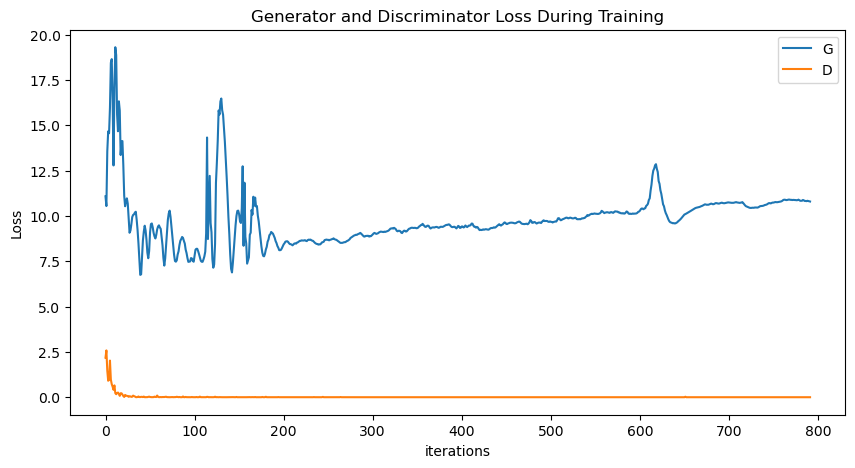

In [36]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

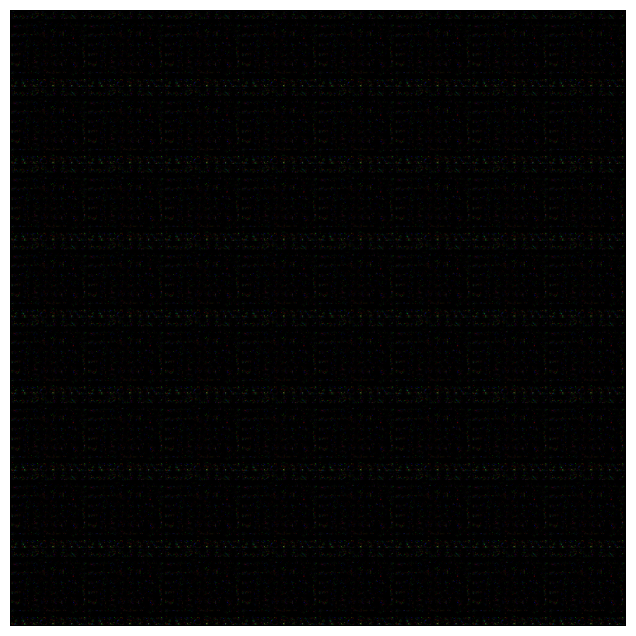

In [37]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

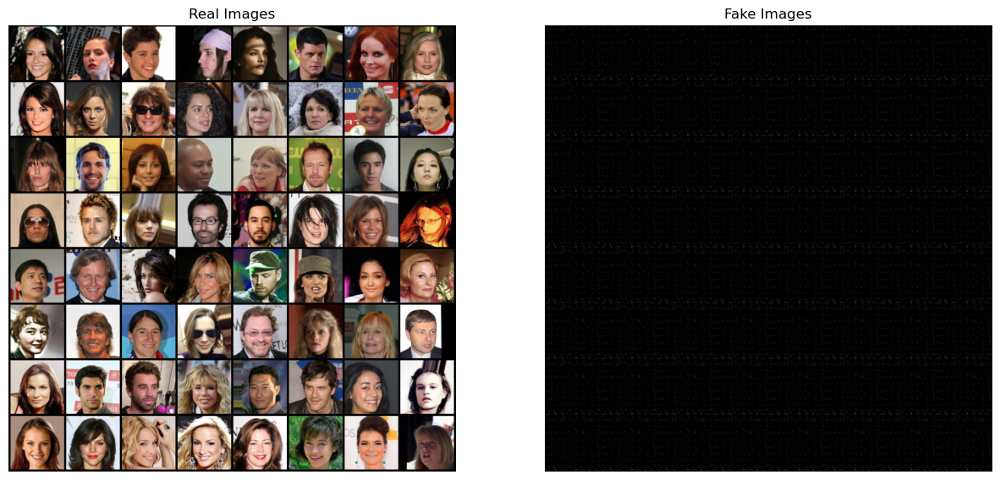

wandb: While tearing down the service manager. The following error has occurred: [WinError 10054] An existing connection was forcibly closed by the remote host


In [38]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

# Попытка добиться сходимости

In [8]:
# Дирректория с изображениями
#dataroot = "C:\\Users\\Sky\\EveryPixel\\Project_Edu\\img_align_celeba"
dataroot = "C:/Users/Andrej/1_GAN_2/img_align_celeba"
# Количество воркеров для сборки датасета
workers = 2

# Размер батча
batch_size = 128*2

# Размер входа сети для изображений. Все изображения ресайзятся к нему
image_size = 128

# Количество каналов цвета
nc = 3

# Размер латентного вектора (размерность латентного пространства)
nz = 100

# Size of feature maps in generator
ngf = 128

# Рамер карты признаков для генератора
ndf = 128

# Кол-во эпох
num_epochs = 5

# Лернингрейт
lr = 0.0002

# Параметр для оптимизатора Adam
beta1 = 0.9

# Количество GPU, 0 если считаем на CPU
ngpu = 1

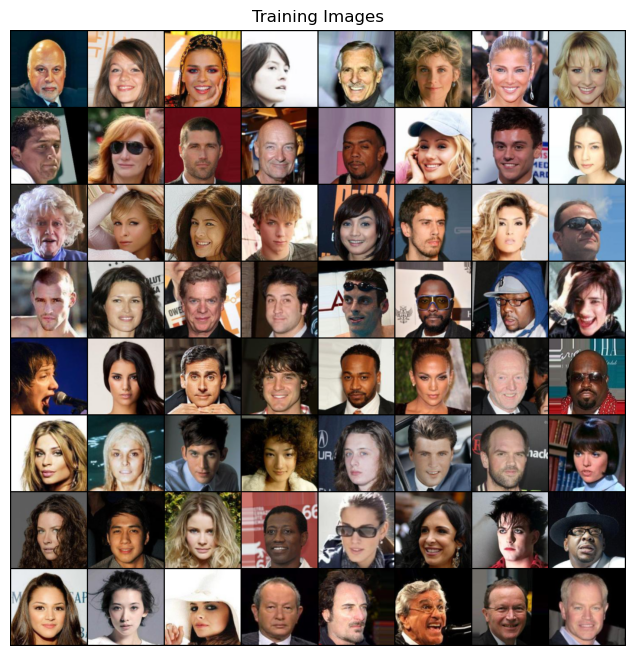

In [32]:
# Для создания датасета используем класс ImageFolder
# Создаем датасет
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Создаем даталоадер
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Выбираем девайс для вычислений
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Нарисуем часть картинок из датасета
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [33]:
# кастомная инициализация весов netG или netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [34]:
class CSPupBlock(nn.Module):
    def __init__(self, npf):
        super(CSPupBlock, self).__init__()
        #Aux
        ## При учете если npf = 256
        #self.deconv = nn.ConvTranspose2d( 100, npf*2, 8, 1, 0, bias=False) # shape (1,100, 1, 1) -> (1,1024, 8, 8)
        
        self.deconv = nn.ConvTranspose2d( nz, npf, 8, 1, 0, bias=False) # shape (1,100, 1, 1) -> (1,1024, 4, 4)
        self.norm = nn.BatchNorm2d(npf)
        self.rel = nn.LeakyReLU(0.2, inplace=True)
        
        #Split 1
        self.upsample0_0 = nn.ConvTranspose2d(npf, npf, kernel_size = 4,stride = 2, padding = 1, bias=False)
        #self.norm0_0 = nn.InstanceNorm2d(npf)
        self.norm0_0 = nn.BatchNorm2d(npf)
        
        
        #Split 2
        self.conv1d0_1 = nn.Conv1d(npf, npf,kernel_size = 3, stride=1, padding = 1, bias=False)
        #self.norm0_1= nn.InstanceNorm1d(npf)
        self.norm0_1= nn.BatchNorm1d(npf)
        
        self.relu0_1 = nn.LeakyReLU(0.2, inplace=True)
        
        self.upsample1_1 = nn.ConvTranspose2d(npf, npf, kernel_size = 4,stride = 2, padding = 1, bias=False)
        #self.norm1_1 = nn.InstanceNorm2d(npf)
        self.norm1_1 = nn.BatchNorm2d(npf)
        
        self.conv3d0_1 = nn.Conv3d(npf, npf, kernel_size = 3, stride=1, padding = 1, bias=False)
        #self.norm2_1 = nn.InstanceNorm3d(npf)
        self.norm2_1 = nn.BatchNorm3d(npf)
        
        self.relu1_1 = nn.LeakyReLU(0.2, inplace=True)
        
        self.conv3d1_1 = nn.Conv3d(npf, npf, kernel_size = 3, stride=1, padding = 1, bias=False)
        #self.norm3_1 = nn.InstanceNorm3d(npf)
        self.norm3_1 = nn.BatchNorm3d(npf)

    def forward(self,x):
        B_num, Ch, H, W = x.size()
        #print(B_num, Ch, H, W)
        
        if (H == 1 and W == 1):
            #Так как по видео памяти не вытягивает машина - скипнули блок с глубиной 1024, начинаем с npf = 512
            ## shape (1,100, 1, 1) -> (1,1024, 4, 4)
            x = self.deconv(x)
            x = self.norm(x)
            x = self.rel(x)
            #B_num, Ch, H, W = x.size()
            #print(x.size())
            return x
        else:
            #shape (1,512, 4, 4) -> (1,256, 4, 4) , (1,256, 4, 4)
            x_1, x_2 = x[:,Ch//2:,:,:] , x[:,:Ch//2,:,:]
    
            #Split 1
            #Upsample
            ## shape (1,256, 4, 4) -> (1,256, 8, 8)
            x_1 = self.upsample0_0(x_1)
            x_1 = self.norm0_0(x_1)
    
    
            #Split 2
            ## shape (1,256, 4, 4) -> (1,256, 16)
            ## Для уверенности в сохранности памяти рекомендуют использовать view
            #x_2 = x_2.reshape(B_num, Ch//2, H*W)
            x_2 = x_2.view(B_num, Ch//2, H*W)
            
            #Conv1
            x_2 = self.conv1d0_1(x_2)
            x_2 = self.norm0_1(x_2)
    
            #Relu
            x_2 = self.relu0_1(x_2)
    
            ## shape (1,256, 16) -> (1,256, 4, 4)
            x_2 = x_2.view(B_num, Ch//2, H, W)
    
            ## shape (1,256, 4, 4) -> (1,256, 8, 8)
            # Upsample
            x_2 = self.upsample1_1(x_2)
            x_2 = self.norm1_1(x_2)
    
    
            ## shape (1,256, 8, 8) -> (1,256, 1, 8, 8)
            x_2 = x_2.view(B_num,Ch//2, 1, 2*H ,2*W)
    
            #conv3
            x_2 = self.conv3d0_1(x_2)
            x_2 = self.norm2_1(x_2)
            #Relu
            x_2 = self.relu1_1(x_2)
            #conv3
            x_2 = self.conv3d1_1(x_2)
            x_2 = self.norm3_1(x_2)
            ## shape (1,256, 1, 8, 8) -> (1,256, 8, 8)
            x_2 = x_2.view(B_num,Ch//2, 2*H ,2*W)
        
            return x_1 + x_2
        

In [35]:
# Имплементация генератора
# Генерируем батч латентных векторов
        #noise = torch.randn(b_size, nz, 1, 1, device=device)
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # вход Z, идет в convolution

            # state size. (100) x 1 x 1
            
            CSPupBlock(512),
            # state size. (512) x 8 x 8
            nn.Dropout(p=0.2),

            CSPupBlock(512//(2**1)),
            nn.Dropout(p=0.2),
            # state size. (256) x 16 x 16
            
            CSPupBlock(512//(2**2)),
            nn.Dropout(p=0.2),
            # state size. (128) x 32 x 32
            
            CSPupBlock(512//(2**3)),
            nn.Dropout(p=0.2),
            # state size. (64) x 64 x 64
            nn.ConvTranspose2d(64, 3, kernel_size = 4,stride = 2, padding = 1, bias=False),
            #nn.BatchNorm2d(3),
            #nn.ReLU(True)
            nn.Tanh()
            # state size. (3) x 128 x 128

        )

    def forward(self, input):
        return self.main(input)

In [36]:
# Инициализируем генератор
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Инициализируем веса
netG.apply(weights_init)

print(netG)

Generator(
  (main): Sequential(
    (0): CSPupBlock(
      (deconv): ConvTranspose2d(100, 512, kernel_size=(8, 8), stride=(1, 1), bias=False)
      (norm): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (rel): LeakyReLU(negative_slope=0.2, inplace=True)
      (upsample0_0): ConvTranspose2d(512, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (norm0_0): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv1d0_1): Conv1d(512, 512, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
      (norm0_1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu0_1): LeakyReLU(negative_slope=0.2, inplace=True)
      (upsample1_1): ConvTranspose2d(512, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (norm1_1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3d0_1): Conv3d(512, 512, k

In [24]:
# # Имплементация дискриминатора
"""
Простенькая версия с попыткой усложнения архитектуры через тип слоев, а не их количество
"""
# class Discriminator(nn.Module):
#     def __init__(self, ngpu):
#         super(Discriminator, self).__init__()
#         self.ngpu = ngpu
#         self.main = nn.Sequential(
#             # input is (nc) x 128 x 128
#             nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
#             nn.LeakyReLU(0.2, inplace=True),
#             #nn.Dropout(p=0.2),
#             # input is (ndf) x 64 x 64
#             nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(ndf * 2),
#             nn.LeakyReLU(0.2, inplace=True),
#             #nn.Dropout(p=0.2),
            
#             # state size. (ndf*2) x 32 x 32
#             nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(ndf * 4),
#             nn.LeakyReLU(0.2, inplace=True),
#             #nn.Dropout(p=0.2),
            
#             # state size. (ndf*2) x 16 x 16
#             nn.Conv2d(ndf * 4, ndf * 4, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(ndf * 4),
#             nn.LeakyReLU(0.2, inplace=True),
#             nn.Dropout(p=0.2),
#             # state size. (ndf*4) x 8 x 8

#             # nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
#             # nn.BatchNorm2d(ndf * 8),
#             # nn.LeakyReLU(0.2, inplace=True),
            
#             # state size. (ndf*4) x 4 x 4
#             nn.Conv2d(ndf * 4, 1, 8, 1, 0, bias=False),
#             nn.Sigmoid()
#         )

#     def forward(self, input):
#         return self.main(input)

'\nПростенькая версия с попыткой усложнения архитектуры через тип слоев, а не их количество\n'

In [25]:
# # Имплементация дискриминатора
"""
Усложнение дискременатора через добавление подобных слоев :
            # nn.Conv2d(ndf * 4, ndf * 4, kernel_size = 3, stride=1, padding = 1, bias=False),
            # nn.BatchNorm2d(ndf * 4),
            # nn.LeakyReLU(0.2, inplace=True),
Они никак не изменяют размерность тензора, просто усложняют архитектуру через количество слоев
"""
# class Discriminator(nn.Module):
#     def __init__(self, ngpu):
#         super(Discriminator, self).__init__()
#         self.ngpu = ngpu
#         self.main = nn.Sequential(
            
#             # input is (nc)((3)) x 128 x 128
#             nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
#             #nn.BatchNorm2d(ndf),
#             nn.LeakyReLU(0.2, inplace=True),
#             # state size. (ndf)((128)) x 64 x 64
            
#             ### Dummy layer
#             nn.Conv2d(ndf, ndf, kernel_size = 3, stride=1, padding = 1, bias=False),
#             nn.BatchNorm2d(ndf),
#             #nn.LeakyReLU(0.2, inplace=True),
#             #nn.Dropout(p=0.2),
#             nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(ndf*2),
#             nn.LeakyReLU(0.2, inplace=True),
#             # state size. (ndf)((128)) x 32 x 32

#             ### Dummy layer
#             #nn.Conv2d(ndf, ndf*2, kernel_size = 3, stride=1, padding = 1, bias=False),
#             # nn.BatchNorm2d(ndf*2),
#             # nn.LeakyReLU(0.2, inplace=True),
            
#             nn.Conv2d(ndf*2, ndf * 4, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(ndf * 4),
#             nn.LeakyReLU(0.2, inplace=True),
#             # state size. (ndf*2)((256)) x 16 x 16

#             ### Dummy layer
#             #nn.Conv2d(ndf * 2, ndf * 4, kernel_size = 3, stride=1, padding = 1, bias=False),
#             #nn.BatchNorm2d(ndf * 4),
#             #nn.LeakyReLU(0.2, inplace=True),
            
#             nn.Conv2d(ndf * 4, ndf * 4, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(ndf * 4),
#             nn.LeakyReLU(0.2, inplace=True),
#             # state size. (ndf*4)((512)) x 8 x 8

#             # nn.Conv2d(ndf * 4, ndf * 4, kernel_size = 3, stride=1, padding = 1, bias=False),
#             # nn.BatchNorm2d(ndf * 4),
#             # nn.LeakyReLU(0.2, inplace=True),

#             # nn.Conv2d(ndf * 4, ndf * 4, kernel_size = 3, stride=1, padding = 1, bias=False),
#             # nn.BatchNorm2d(ndf * 4),
#             # nn.LeakyReLU(0.2, inplace=True),

#             # nn.Conv2d(ndf * 4, ndf * 4, kernel_size = 3, stride=1, padding = 1, bias=False),
#             # nn.BatchNorm2d(ndf * 4),
#             # nn.LeakyReLU(0.2, inplace=True),

#             # state size. (ndf*4)((512)) x 8 x 8
            
# #             nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
# #             nn.BatchNorm2d(ndf * 8),
# #             nn.LeakyReLU(0.2, inplace=True),
# #             # state size. (ndf*8) x 4 x 4
#             ##in_ch, out_ch, kern, stride, padding
#             nn.Conv2d(ndf * 4, 1, 8, 1, 0, bias=False),
#             nn.Sigmoid()
#         )

#     def forward(self, input):
#         #Print()
#         return self.main(input)

In [37]:
# # Имплементация дискриминатора
"""
Одна из первых версий, простая, с добавлением слоя-пустышки, для усложнения архитектуры:
            nn.Conv2d(ndf * 4, ndf * 4, kernel_size = 3, stride=1, padding = 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
"""
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc)((3)) x 128 x 128
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf)((128)) x 64 x 64
            
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf)((128)) x 32 x 32
            
            nn.Conv2d(ndf*2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2)((256)) x 16 x 16
            
            nn.Conv2d(ndf * 4, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4)((512)) x 8 x 8

            nn.Conv2d(ndf * 4, ndf * 4, kernel_size = 3, stride=1, padding = 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 4, ndf * 4, kernel_size = 3, stride=1, padding = 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. (ndf*4)((512)) x 8 x 8
            
#             nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(ndf * 8),
#             nn.LeakyReLU(0.2, inplace=True),
#             # state size. (ndf*8) x 4 x 4
            ##in_ch, out_ch, kern, stride, padding
            nn.Conv2d(ndf * 4, 1, 8, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        #Print()
        return self.main(input)

In [38]:
# инициализируем дискриминатор
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Инициализируем веса
netD.apply(weights_init)

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Conv2d(512, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): Conv2d(512, 512, kernel_s

In [39]:
# Инициализируем лосс
criterion = nn.BCELoss()

# Создаем батч с рандомным шумом для генерации
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Метки для реальных данных и фековых
real_label = 1.
fake_label = 0.

# Устанавливаем оптимизаторы для G и D
"""
### Регуляция lr -> если маленький, то генератор быстро переигрывает дискриминатор, и лос дискриминатора улетает вверх, 
большой lr -> дискриминатор быстро обучается до loss < 0.5 и лосс генератора начинает увеличиваться
"""
optimizerD = optim.SGD(netD.parameters(), lr=lr*1.0)
#optimizerD = optim.Adam(netD.parameters(), lr=lr*1, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [40]:
torch.cuda.empty_cache()

In [41]:
torch.cuda.is_available()

True

In [ ]:
run = wandb.init(project="DCGANmoded")

In [240]:
config = run.config

In [241]:
run.watch(netD)

In [242]:
run.watch(netG)

In [42]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# Для каждой эпохи
for epoch in range(num_epochs):
    # Для каждого батча
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Учим дискриминатор: максимизируем log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Для батча
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Прямой прогон батча из реальных картинок D
        output = netD(real_cpu).view(-1)
        # Считаем лосс на всем батче реальных картинок
        errD_real = criterion(output, label)
        # Вычисляем градиенты для дискриминатора
        errD_real.backward()
        D_x = output.mean().item()

        ## Учим на полном фейковом батче
        # Генерируем бат латентных векторов
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Генерируем фековый батч с помощью G
        fake = netG(noise)
        label.fill_(fake_label)
        # Классифицируем фековый батч с помощью D
        output = netD(fake.detach()).view(-1)
        # Вычисляем лосс дискриминатора на фейковом батче
        errD_fake = criterion(output, label)
        # Вычисляем градиент для фейкового батча, он суммируется с предидущим
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Вычисляем ошибку на реальном и фековом батчах
        errD = errD_real + errD_fake
        # Обновляем веса D
        optimizerD.step()

        ############################
        # (2) Учим генератор: максимизируем log(D(G(z)))
        ###########################
        if iters % 2 == 0:
            netG.zero_grad()
            label.fill_(real_label)  # для генератора фейковые метки есть реальные (0 меняем на 1)
            # Так как мы обновили веса дискриминатора прогоним фековый батч через него еще  раз
            output = netD(fake).view(-1)
            # Вычислим лосс G основываясь на выходе D
            errG = criterion(output, label)
            # Вычислим градиент для G
            errG.backward()
            D_G_z2 = output.mean().item()
            # Обновляем веса G
            optimizerG.step()

        # Выводим статистику обучения
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Сохраним лоссы
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        # run.log({"lossD": errD})
        # run.log({"lossG": errG})

        # Проверим какие картинки рисует генератор
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/5][0/792]	Loss_D: 2.4711	Loss_G: 1.4579	D(x): 0.3352	D(G(z)): 0.3966 / 0.4166
[0/5][50/792]	Loss_D: 2.6709	Loss_G: 2.2823	D(x): 0.6302	D(G(z)): 0.3952 / 0.2200
[0/5][100/792]	Loss_D: 1.7423	Loss_G: 3.7471	D(x): 0.7170	D(G(z)): 0.1046 / 0.0813
[0/5][150/792]	Loss_D: 2.4201	Loss_G: 3.8057	D(x): 0.6060	D(G(z)): 0.0675 / 0.0759
[0/5][200/792]	Loss_D: 3.0964	Loss_G: 3.3688	D(x): 0.6142	D(G(z)): 0.1410 / 0.1077
[0/5][250/792]	Loss_D: 3.2037	Loss_G: 3.6034	D(x): 0.6307	D(G(z)): 0.0902 / 0.0811
[0/5][300/792]	Loss_D: 3.7599	Loss_G: 4.2058	D(x): 0.6197	D(G(z)): 0.0314 / 0.0415
[0/5][350/792]	Loss_D: 2.5978	Loss_G: 4.2187	D(x): 0.6961	D(G(z)): 0.0221 / 0.0291
[0/5][400/792]	Loss_D: 2.9669	Loss_G: 4.5767	D(x): 0.7353	D(G(z)): 0.0149 / 0.0193
[0/5][450/792]	Loss_D: 2.3598	Loss_G: 4.5433	D(x): 0.7373	D(G(z)): 0.0156 / 0.0203
[0/5][500/792]	Loss_D: 2.6024	Loss_G: 4.2923	D(x): 0.7323	D(G(z)): 0.0198 / 0.0250
[0/5][550/792]	Loss_D: 3.2133	Loss_G: 4.2499	D(x): 0.7401	D(G(z)

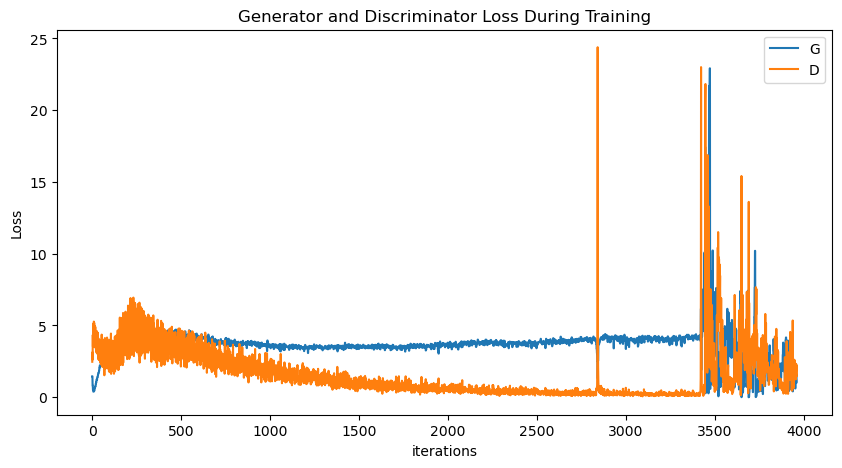

In [43]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Screamer alert

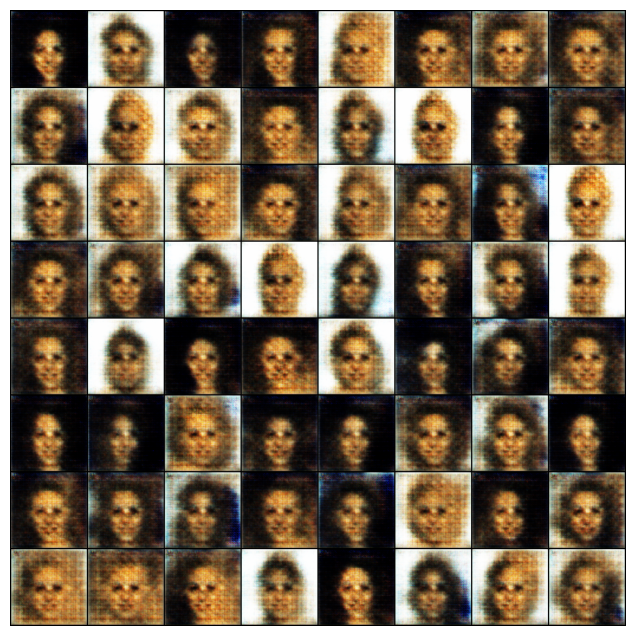

In [44]:

#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())
### Получается белый шум скорее вместо результат

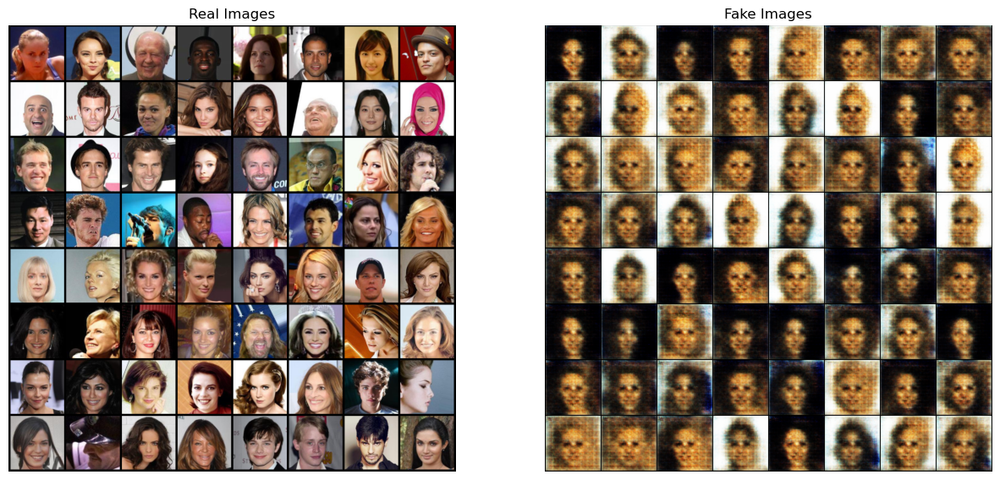

In [45]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [58]:
torch.save(netG,'Test/netG.pt')
torch.save(netD,'Test/netD.pt')
torch.save(netG.state_dict(), 'Test/netG.pth')
torch.save(netD.state_dict(), 'Test/netD.pth')

# Вывод

Улучшил результат, правда ушло на обучение 4.5 часов, не могу разобраться пока что в чем дело, для обычного DCGAN требуется 10 мин на обучение 5 эпох. Правда при обучении этой модели видео память почти впритык была, может быть в этом дело.
Видно что если бы было больше эпох то картинки получились лучше. И любопытно что за расхождение началось в конце.

На этот запуск не было веры, поэтому не включил wandb.
Попробую ещё улучшить результат.

Ссылка на Wandb предыдущих запусков: https://wandb.ai/anzovitte/DCGANmoded?nw=nwuseranzovi